<a href="https://colab.research.google.com/github/sid-vt/Mercedez-Benz-Optimizing-Testing-Time/blob/main/Mercedes_Benz_Testing_Time_Optimization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# DATA ANALYTICS: Fall 2020
Project Data Visualization

Name  : Siddharth Jain

email : siddharthj@vt.edu

Date  : 10 December 2020

---




In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.preprocessing import LabelEncoder

In [2]:
trainData = pd.read_csv("train.csv")
testData = pd.read_csv("test.csv")

FileNotFoundError: ignored

In [ ]:
#Return 10 rows:
trainData.head(10)

In [ ]:
dataType = trainData.dtypes.reset_index()
dataType.columns = ["Feature Name","dtypes"]
dataType.groupby("dtypes").agg("count").reset_index()

In [3]:
fig = plt.figure(figsize=(10,10))
sns.histplot(data=trainData['y'], kde=True)

plt.grid(True)
plt.title("Histogram of Output Values", fontsize = 15)
plt.xlabel("Y Values (testing duration)", fontsize = 15)
plt.ylabel("Number of data Points", fontsize = 15)
plt.text(10, 400, 'The majority of test durations are between 90 and 100 seconds', fontsize = 12)

NameError: ignored

<Figure size 720x720 with 0 Axes>

In [ ]:
fig = plt.figure(figsize=(10,10))
sns.scatterplot(data = np.sort(trainData['y']))

plt.grid(True)
plt.title("Scatter of Output Values", fontsize = 15)
plt.ylabel("Y Values (testing duration)", fontsize = 15)
plt.xlabel("Number of data Points", fontsize = 15)

In [4]:
# Finding the Outlier

outliers = np.where(trainData['y']>175)

NameError: ignored

In [ ]:
labels = []
zeroCount = []
oneCount = []
for i in testData.columns[1:]:
    if trainData[i].dtype == 'int64':
        labels.append(i)
        zeroCount.append((trainData[i]==0).sum())
        oneCount.append((trainData[i]==1).sum())

In [5]:
## Command to check if the ZERO Count and ONE count equals total number of data columns

for index, (i, j) in enumerate(zip(zeroCount, oneCount)):
    chk = i+j
    if not chk==4209:
        print(index);

NameError: ignored

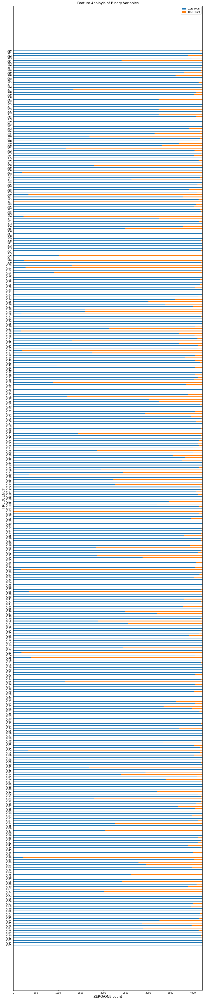

In [ ]:
x = np.arange(len(labels)) 
width = 0.30

plt.figure(figsize=(15,80))
rects1 = plt.barh(x[::-1], zeroCount, width)
rects2 = plt.barh(x[::-1], oneCount, width, left = zeroCount)
plt.legend((rects1[0], rects2[0]), ('Zero count', 'One Count'))
plt.yticks(x[::-1], labels)
plt.title("Feature Analayis of Binary Variables", fontsize = 15)
plt.xlabel("ZERO/ONE count", fontsize = 15)
plt.ylabel("FREQUENCY", fontsize = 15)
plt.show()

In [ ]:
wasteFeatures = []
for index, (i, j) in enumerate(zip(zeroCount, oneCount)):
    if not i or j == 0:
        wasteFeatures.append(trainData.columns[10:][index])

In [ ]:
wasteFeatures

['X11',
 'X93',
 'X107',
 'X233',
 'X235',
 'X268',
 'X289',
 'X290',
 'X293',
 'X297',
 'X330',
 'X347']

In [ ]:
trainData.iloc[:,0:10].head()

,ID,y,X0,X1,X2,X3,X4,X5,X6,X8
0,0,130.81,k,v,at,a,d,u,j,o
1,6,88.53,k,t,av,e,d,y,l,o
2,7,76.26,az,w,n,c,d,x,j,x
3,9,80.62,az,t,n,f,d,x,l,e
4,13,78.02,az,v,n,f,d,h,d,n


In [ ]:
LE = LabelEncoder()
for i in trainData.columns:
    if trainData[i].dtype == 'object':
        LE.fit(list(trainData[i].values)+list(testData[i].values))
        trainData[i] = LE.transform(trainData[i].values)
        testData[i] = LE.transform(testData[i].values)

In [ ]:
trainData.iloc[:,0:10].head()

,ID,y,X0,X1,X2,X3,X4,X5,X6,X8
0,0,130.81,37,23,20,0,3,27,9,14
1,6,88.53,37,21,22,4,3,31,11,14
2,7,76.26,24,24,38,2,3,30,9,23
3,9,80.62,24,21,38,5,3,30,11,4
4,13,78.02,24,23,38,5,3,14,3,13


In [ ]:
# Cleaning Data, removing features that are not usefull for regression problem because they have 0 variance
trainData_cleaned = trainData.drop(index = outliers[0], columns=wasteFeatures, axis=1)
testData_cleaned = testData.drop(columns=wasteFeatures, axis=1)

trainData_cleaned.to_csv('trainData_clean.csv', index = False)
testData_cleaned.to_csv('testData_clean.csv', index = False)

In [ ]:
categData = trainData.iloc[:,2:10]
categData.head(10)

,X0,X1,X2,X3,X4,X5,X6,X8
0,37,23,20,0,3,27,9,14
1,37,21,22,4,3,31,11,14
2,24,24,38,2,3,30,9,23
3,24,21,38,5,3,30,11,4
4,24,23,38,5,3,14,3,13
5,46,3,29,2,3,13,7,18
6,11,19,29,5,3,12,7,18
7,41,13,19,5,3,12,9,0
8,49,20,19,4,3,12,8,7
9,36,3,17,2,3,12,0,4


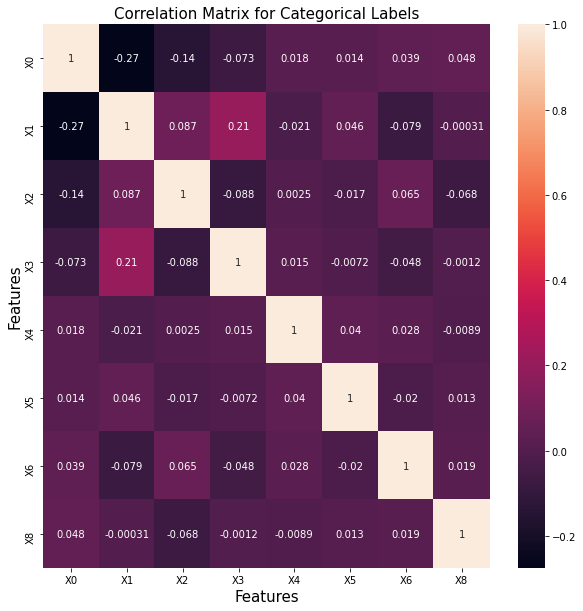

In [ ]:
categCorr = categData.corr()

plt.figure(figsize=(10,10))
sns.heatmap(categCorr, annot=True)

plt.title("Correlation Matrix for Categorical Labels", fontsize = 15)
plt.ylabel("Features", fontsize = 15)
plt.xlabel("Features", fontsize = 15)
plt.show()



In [ ]:
binData = trainData.iloc[:,10:]
binData.head(10)

,X10,X11,X12,X13,X14,X15,X16,X17,X18,X19,...,X375,X376,X377,X378,X379,X380,X382,X383,X384,X385
0,0,0,0,1,0,0,0,0,1,0,...,0,0,1,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,1,0,...,1,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,1,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
6,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,1,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
9,0,0,0,0,1,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0


In [ ]:
binCorr = binData.corr()

plt.figure(figsize=(200,200))
sns.heatmap(binCorr, annot=True)

plt.title("Correlation Matrix for Categorical Labels", fontsize = 100)
plt.ylabel("Features", fontsize = 100)
plt.xlabel("Features", fontsize = 100)
plt.show()


In [ ]:
binCorr

,X10,X11,X12,X13,X14,X15,X16,X17,X18,X19,...,X375,X376,X377,X378,X379,X380,X382,X383,X384,X385
X10,1.000000,NaN,-0.033084,-0.028806,-0.100474,-0.002532,-0.005944,-0.010164,-0.010323,-0.038610,...,0.165277,-0.028618,-0.074244,-0.016870,-0.011374,-0.010479,-0.010164,-0.004740,-0.002532,-0.004387
X11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
X12,-0.033084,NaN,1.000000,0.214825,-0.246513,-0.006212,-0.014584,-0.024937,-0.025327,-0.094730,...,-0.107864,-0.070214,0.030134,-0.016043,-0.027907,-0.005566,-0.024937,-0.011628,-0.006212,-0.010765
X13,-0.028806,NaN,0.214825,1.000000,-0.083141,-0.005409,-0.012698,-0.021713,-0.010525,-0.082482,...,-0.169721,-0.061136,0.357229,-0.036040,-0.024299,0.023045,-0.021713,-0.010125,0.041242,-0.009373
X14,-0.100474,NaN,-0.246513,-0.083141,1.000000,-0.018865,-0.044291,0.012713,-0.076916,-0.287691,...,0.118950,0.026496,-0.097464,-0.037958,0.103309,0.007743,0.012713,0.023604,0.025199,0.043667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
X380,-0.010479,NaN,-0.005566,0.023045,0.007743,-0.001968,-0.004619,-0.007899,-0.008022,-0.021140,...,-0.061741,-0.022240,-0.061168,-0.013110,-0.008839,1.000000,-0.007899,-0.003683,-0.001968,-0.003410
X382,-0.010164,NaN,-0.024937,-0.021713,0.012713,-0.001908,-0.004480,1.000000,0.085256,-0.029102,...,-0.059883,-0.021571,-0.059327,-0.012716,-0.008573,-0.007899,1.000000,-0.003572,-0.001908,-0.003307
X383,-0.004740,NaN,-0.011628,-0.010125,0.023604,-0.000890,-0.002089,-0.003572,0.062481,-0.013571,...,-0.015413,-0.010059,0.035107,-0.005930,-0.003998,-0.003683,-0.003572,1.000000,-0.000890,-0.001542
X384,-0.002532,NaN,-0.006212,0.041242,0.025199,-0.000475,-0.001116,-0.001908,-0.001938,-0.007250,...,-0.014917,-0.005373,0.008694,-0.003168,-0.002136,-0.001968,-0.001908,-0.000890,1.000000,-0.000824


In [ ]:
nanCorr = binCorr.isnull().apply(lambda x: all(x), axis=1)
nanCorr.index[np.where(nanCorr)[0]]

Index(['X11', 'X93', 'X107', 'X233', 'X235', 'X268', 'X289', 'X290', 'X293',
       'X297', 'X330', 'X347'],
      dtype='object')